# Data Exploration 

In [1]:
import os
import numpy as np
import matplotlib.pylab as plt
import json
import random
import re

import shapely.geometry
import geopandas as gpd
import geopandas_osm.osm
import rasterio
from collections import Counter

%matplotlib inline

In [2]:
def scale_bands(img, lower_pct = 1, upper_pct = 99):
    """
    Rescale the bands of a multichannel image for display
    """
    # Loop through the image bands, rescaling each one
    img_scaled = np.zeros(img.shape, np.uint8)
    
    for i in range(img.shape[2]):
        
        band = img[:, :, i]
        
        # Pick out the lower and upper percentiles
        lower, upper = np.percentile(band, [lower_pct, upper_pct])
        
        # Normalize the band
        band = (band - lower) / (upper - lower) * 255
        
        # Clip the high and low values, and cast to uint8
        img_scaled[:, :, i] = np.clip(band, 0, 255).astype(np.uint8)
        
    return img_scaled

# Houston

# Inventory of all Pre-Harvey images 

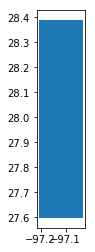

In [3]:
image_dir_path = 'Data/Spacenet/Harvey/Pre_event/02.23.17/'
tiff_images = []
# Collect a list of all the images with the .tif extension
tiff_images = [os.path.join(path,f)
             for path,_,files in os.walk(image_dir_path) 
             for f in files if f.endswith('tif')]
res = []
for image_file_name in tiff_images:
    with rasterio.open(image_file_name) as src:
        # Convert the image bounding box into a shapely polygon
        bbox = shapely.geometry.box(*src.bounds)
    res.append((image_file_name, bbox))

# Convert the results into a GeoDataFrame
Pre_harvey_summary = gpd.GeoDataFrame(res, columns=['image_name', 'geometry'], crs={'init': 'epsg:4326'})
Pre_harvey_summary.plot()

In [6]:
output_file_name = 'vectors/Pre_harvey_summary.geojson'

# Make sure the file doesnt exist (the program will crash if it does)
if os.path.exists(output_file_name):
    os.remove(output_file_name)

# Save the file as a geojson
Pre_harvey_summary.to_file(output_file_name, driver='GeoJSON')
Pre_harvey_summary.shape

(18, 2)

## Viewing a sample 

(19584, 19584, 3)
CRS({'init': u'epsg:4326'})
[-97.20703125, 4.487879136029412e-06, 0.0, 28.212890625, 0.0, -4.487879136029412e-06]
BoundingBox(left=-97.20703125, bottom=28.125, right=-97.119140625, top=28.212890625)


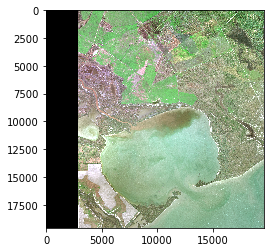

In [121]:
src1 = rasterio.open(random.choice(tiff_images))
img1 = src1.read([1, 2, 3]).transpose([1,2,0])
plt.imshow(scale_bands(img1))
print(src1.width, src1.height, src1.count)
print(src1.crs)
print(src1.transform)
print(src1.bounds)

## Viewing Feautures in Houston via Open Street Map

In [4]:
pre_harvey_meta_df = gpd.read_file('vectors/Pre_harvey_summary.geojson')
poly = shapely.geometry.box(*pre_harvey_meta_df.unary_union.bounds)

### Buildings 

In [4]:
pre_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='building')
building_columns = pre_harvey_df.columns

buildings = pre_harvey_df[~pre_harvey_df.building.isnull()][['building', 'name', 'geometry']]
pre_harvey_building_centroids = buildings.set_geometry(buildings.centroid, inplace=False)
print(pre_harvey_building_centroids.building.unique())
print(pre_harvey_building_centroids.shape)

/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas_osm/osm.py:299: FutureWarning: by argument to sort_index is deprecated, pls use .sort_values(by=...)
  df = df.sort_index(by='index')[['lon', 'lat']]


['yes' 'house' 'commercial' 'hangar' 'shelter' 'school' 'hotel' 'shed'
 'garage' 'residential' 'roof' 'apartments']
(2360, 3)


### Landuse

In [5]:
pre_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='landuse')
pre_harvey_landuse = pre_harvey_df[~pre_harvey_df.landuse.isnull()]
print(pre_harvey_landuse.landuse.unique())
print(pre_harvey_landuse.shape)

['grass' 'cemetery' 'residential' 'commercial' 'industrial' 'plant_nursery'
 'meadow']
(21, 7)


### Waterway

In [5]:
pre_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='waterway')
pre_harvey_waterways = pre_harvey_df[~pre_harvey_df.waterway.isnull()]
print(pre_harvey_waterways.waterway.unique())
print(pre_harvey_waterways.shape)

['lock_gate' 'river' 'canal' 'riverbank' 'ditch' 'stream' 'dock']
(25, 10)


/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas_osm/osm.py:299: FutureWarning: by argument to sort_index is deprecated, pls use .sort_values(by=...)
  df = df.sort_index(by='index')[['lon', 'lat']]


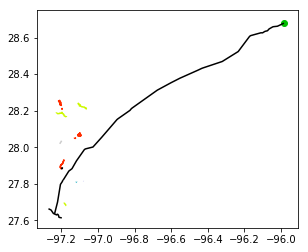

In [6]:
pre_harvey_waterways.plot(column='waterway',cmap='nipy_spectral')

### Natural

In [5]:
pre_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='natural')
pre_harvey_nature = pre_harvey_df[~pre_harvey_df.natural.isnull()]
print(pre_harvey_nature.natural.unique())
print(pre_harvey_nature.shape)

['water' 'wetland' 'beach' 'sand' 'coastline']
(82, 21)


/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas_osm/osm.py:299: FutureWarning: by argument to sort_index is deprecated, pls use .sort_values(by=...)
  df = df.sort_index(by='index')[['lon', 'lat']]


In [6]:
pre_harvey_nature.set_geometry(pre_harvey_nature.geometry.apply(shapely.geometry.Polygon), inplace=True)

/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas/geodataframe.py:149: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  frame[geo_column_name] = level


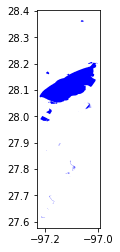

In [15]:
pre_harvey_nature[pre_harvey_nature.natural == 'water'].plot(color='blue')

### Highway

In [10]:
pre_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='highway')
pre_harvey_roads = pre_harvey_df[pre_harvey_df.type == 'LineString'][['highway','name','geometry']]
pre_harvey_roads = pre_harvey_roads[~pre_harvey_roads.highway.isnull()]
print(pre_harvey_roads.highway.unique())
print(pre_harvey_roads.shape)

['residential' 'service' 'track' 'unclassified' 'tertiary_link' 'tertiary'
 'secondary' 'secondary_link' 'primary' 'trunk' 'trunk_link' 'construction'
 'footway' 'road' 'path' 'pedestrian' 'living_street']
(2780, 3)


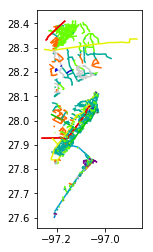

In [11]:
pre_harvey_roads.plot(column='highway',cmap='nipy_spectral')

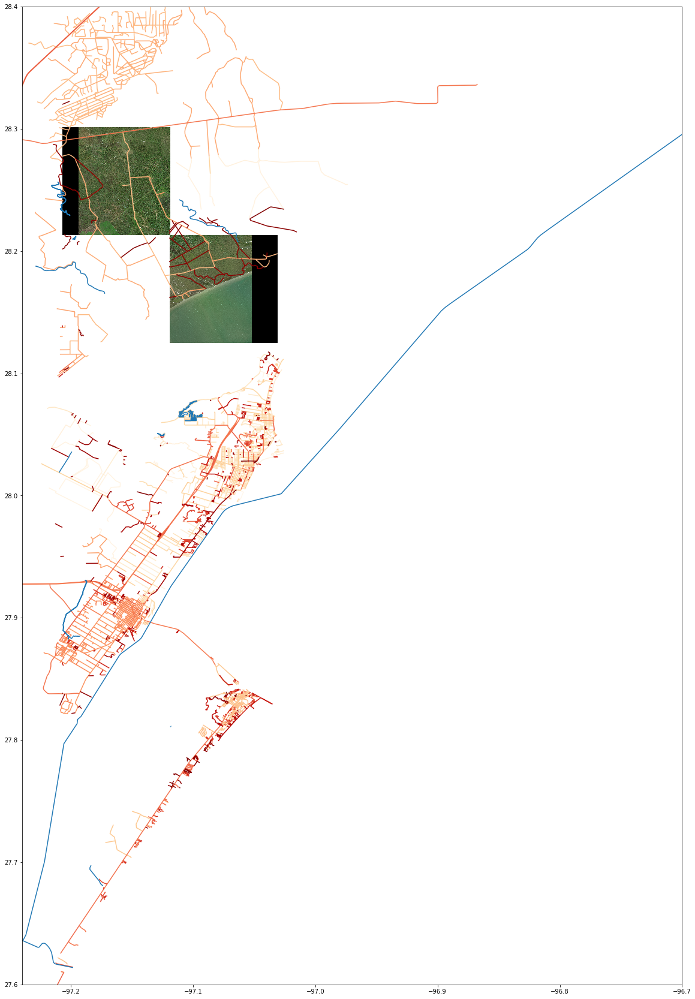

In [26]:
import rasterio.plot as rioplot
src1 = rasterio.open(random.choice(tiff_images))
src2 = rasterio.open(random.choice(tiff_images))
fig, ax = plt.subplots(figsize=(30, 30))
rioplot.show(src1, with_bounds=True,ax=ax)
rioplot.show(src2, with_bounds=True,ax=ax)
pre_harvey_roads.plot(ax=ax,cmap='OrRd')
pre_harvey_waterways.plot(ax=ax)
plt.ylim([27.6,28.4])
plt.xlim([-97.24,-96.7])
plt.show()

In [27]:
import gc
del src1
del src2
gc.collect()

23394

In [7]:
#Coordinates
part1 = pre_harvey_nature[pre_harvey_nature.natural == 'water'].unary_union

images_containing_water = pre_harvey_meta_df[pre_harvey_meta_df.intersects(part1)]
images_containing_water.head()

,image_name,geometry
0,Data/Spacenet/Harvey/Pre_event/02.23.17/032313...,"POLYGON ((-97.119140625 27.59765625, -97.11914..."
1,Data/Spacenet/Harvey/Pre_event/02.23.17/032331...,"POLYGON ((-97.03125 27.7734375, -97.03125 27.8..."
2,Data/Spacenet/Harvey/Pre_event/02.23.17/032313...,"POLYGON ((-97.03125 27.685546875, -97.03125 27..."
4,Data/Spacenet/Harvey/Pre_event/02.23.17/032313...,"POLYGON ((-97.119140625 27.685546875, -97.1191..."
8,Data/Spacenet/Harvey/Pre_event/02.23.17/032333...,"POLYGON ((-97.03125 28.037109375, -97.03125 28..."


In [9]:
#Clearing cache
import gc
del src1
del src2
gc.collect()

12

# Post-Harvey 

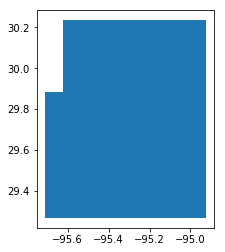

In [3]:
image_dir_path = 'Data/Spacenet/Harvey/Post_event/'
tiff_images = []
# Collect a list of all the images with the .tif extension
tiff_images = [os.path.join(path,f)
             for path,_,files in os.walk(image_dir_path) 
             for f in files if (f.endswith('tif') or f.endswith('tif.1'))]
res = []
for image_file_name in tiff_images:
    with rasterio.open(image_file_name) as src:
        # Convert the image bounding box into a shapely polygon
        bbox = shapely.geometry.box(*src.bounds)
    res.append((image_file_name, bbox))

# Convert the results into a GeoDataFrame
Post_harvey_summary = gpd.GeoDataFrame(res, columns=['image_name', 'geometry'], crs={'init': 'epsg:4326'})
Post_harvey_summary.plot()

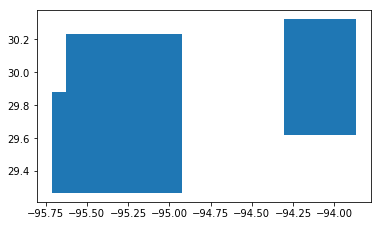

In [17]:
image_dir_path = 'Data/Spacenet/Harvey/Post_event/'
tiff_images1 = []
# Collect a list of all the images with the .tif extension
tiff_images1 = [os.path.join(path,f)
             for path,_,files in os.walk(image_dir_path) 
             for f in files if (f.endswith('tif') or f.endswith('tif.1'))]
image_dir_path = "/media/mlt/Passport 2TB/Morgan's Files/Satellite_Roads_Segmentation/Data/Spacenet/Harvey/Post_event/"
tiff_images2 = []
# Collect a list of all the images with the .tif extension
tiff_images2 = [os.path.join(path,f)
             for path,_,files in os.walk(image_dir_path) 
             for f in files if (f.endswith('tif') or f.endswith('tif.1'))]
tiff_images = tiff_images1+tiff_images2
res = []
for image_file_name in tiff_images:
    with rasterio.open(image_file_name) as src:
        # Convert the image bounding box into a shapely polygon
        bbox = shapely.geometry.box(*src.bounds)
    res.append((image_file_name, bbox))

# Convert the results into a GeoDataFrame
Post_harvey_summary = gpd.GeoDataFrame(res, columns=['image_name', 'geometry'], crs={'init': 'epsg:4326'})
Post_harvey_summary.plot()

In [14]:
output_file_name = 'vectors/Post_harvey_summary.geojson'

# Make sure the file doesnt exist (the program will crash if it does)
if os.path.exists(output_file_name):
    os.remove(output_file_name)

# Save the file as a geojson
Post_harvey_summary.to_file(output_file_name, driver='GeoJSON')
Post_harvey_summary.shape

(117, 2)

## Viewing a sample 

(19584, 19584, 3)
CRS({'init': u'epsg:4326'})
[-95.537109375, 4.487879136029412e-06, 0.0, 29.443359375, 0.0, -4.487879136029412e-06]
BoundingBox(left=-95.537109375, bottom=29.35546875, right=-95.44921875, top=29.443359375)


/home/mlt/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2882: FutureWarning: The value of this property will change in version 1.0. Please see https://github.com/mapbox/rasterio/issues/86 for details.
  exec(code_obj, self.user_global_ns, self.user_ns)


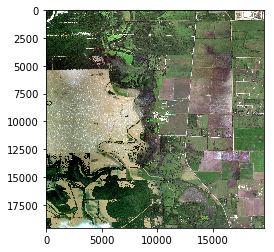

In [4]:
src1 = rasterio.open(random.choice(tiff_images))
img1 = src1.read([1, 2, 3]).transpose([1,2,0])
plt.imshow(scale_bands(img1))
print(src1.width, src1.height, src1.count)
print(src1.crs)
print(src1.transform)
print(src1.bounds)

## Features from Open Street Map

In [4]:
post_harvey_meta_df = gpd.read_file('vectors/Post_harvey_summary.geojson')
poly = shapely.geometry.box(*post_harvey_meta_df.unary_union.bounds)

### Buildings 

In [28]:
post_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='building')
building_columns = post_harvey_df.columns

buildings = post_harvey_df[~post_harvey_df.building.isnull()][['building', 'name', 'geometry']]
post_harvey_building_centroids = buildings.set_geometry(buildings.centroid, inplace=False)
print(post_harvey_building_centroids.building.unique())
print(post_harvey_building_centroids.shape)

['yes' 'entrance' 'house' 'apartments' 'hangar' 'hospital' 'school' 'tower'
 'roof' 'office' 'university' 'college' 'commercial' 'hotel' 'church'
 'industrial' 'warehouse' 'retail' 'gazebo' 'storage_tank' 'garage'
 'dormitory' 'supermarket' 'no' 'stadium' 'sports_centre' 'shop'
 'abandoned' 'bank' 'shopping_center' 'manufacture' 'shed' 'construction'
 'parking' 'residential' 'public' 'greenhouse' 'condominium' 'tank'
 'fire_station' 'restaurant' 'parking_garage' 'kindergarten' 'civic'
 'service' 'terrace' 'farm_auxiliary' 'yes;house' 'detached' 'barn'
 'pavilion' 'stable' 'gasometer' 'static_caravan' 'cabin' 'farm' 'garages'
 'semidetached_house' 'track' 'silo' 'carport']
(93484, 3)


In [30]:
post_harvey_building_centroids.to_file('vectors/post_harvey_building.geojson', driver='GeoJSON')

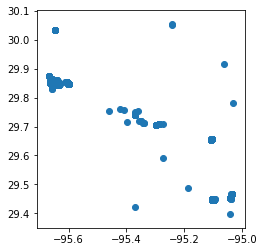

In [20]:
post_harvey_building_centroids[post_harvey_building_centroids.building=='residential'].plot()


### Landuse

In [5]:
post_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='landuse')
post_harvey_landuse = post_harvey_df[~post_harvey_df.landuse.isnull()]
print(post_harvey_landuse.landuse.unique())
print(post_harvey_landuse.shape)

/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas_osm/osm.py:299: FutureWarning: by argument to sort_index is deprecated, pls use .sort_values(by=...)
  df = df.sort_index(by='index')[['lon', 'lat']]


['reservoir' 'commercial' 'industrial' 'forest' 'residential' 'grass'
 'cemetery' 'construction' 'basin' 'retail' 'quarry' 'meadow'
 'village_green' 'harbour' 'pond' 'greenfield' 'place_of_worship' 'school'
 'government' 'religious' 'landfill' 'farmland' 'plant_nursery' 'vineyard'
 'sand' 'mixed' 'recreation_ground' 'brownfield' 'greenhouse_horticulture'
 'churchyard' 'orchard' 'farmyard' 'park' 'civic' 'railway' 'military'
 'garages' 'yes']
(6156, 111)


In [ ]:
post_harvey_landuse.to_file('vectors/post_harvey_landuse.geojson', driver='GeoJSON')

In [17]:
commerical = post_harvey_landuse[post_harvey_landuse.landuse=='commercial'].unary_union
industrial = post_harvey_landuse[post_harvey_landuse.landuse=='industrial'].unary_union
residential = post_harvey_landuse[post_harvey_landuse.landuse=='residential'].unary_union
construction = post_harvey_landuse[post_harvey_landuse.landuse=='construction'].unary_union
retail = post_harvey_landuse[post_harvey_landuse.landuse=='retail'].unary_union
quarry = post_harvey_landuse[post_harvey_landuse.landuse=='quarry'].unary_union
school = post_harvey_landuse[post_harvey_landuse.landuse=='school'].unary_union
government = post_harvey_landuse[post_harvey_landuse.landuse=='government'].unary_union
military = post_harvey_landuse[post_harvey_landuse.landuse=='military'].unary_union

post_harvey_landuse_man = commerical.union(industrial).union(residential).union(construction).union(retail).union(quarry).union(school).union(government).union(military) 



In [36]:
commerical = post_harvey_landuse[post_harvey_landuse.landuse=='commercial']
industrial = post_harvey_landuse[post_harvey_landuse.landuse=='industrial']
residential = post_harvey_landuse[post_harvey_landuse.landuse=='residential']
construction = post_harvey_landuse[post_harvey_landuse.landuse=='construction']
retail = post_harvey_landuse[post_harvey_landuse.landuse=='retail']
quarry = post_harvey_landuse[post_harvey_landuse.landuse=='quarry']
school = post_harvey_landuse[post_harvey_landuse.landuse=='school']
government = post_harvey_landuse[post_harvey_landuse.landuse=='government']
military = post_harvey_landuse[post_harvey_landuse.landuse=='military']



In [40]:
import pandas as pd
post_harvey_landuse_man = gpd.GeoDataFrame(pd.concat([commerical,industrial,residential,construction,retail,quarry,school,government,military ], ignore_index=True))

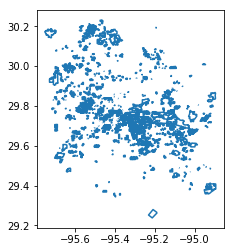

In [42]:
post_harvey_landuse_man.plot()

In [54]:
post_harvey_landuse_man[['landuse', 'name', 'geometry']].to_file('vectors/post_harvey_landuse_man.geojson', driver='GeoJSON')

### Waterway

In [5]:
post_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='waterway')
post_harvey_waterways = post_harvey_df[~post_harvey_df.waterway.isnull()]
print(post_harvey_waterways.waterway.unique())
print(post_harvey_waterways.shape)

/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas_osm/osm.py:299: FutureWarning: by argument to sort_index is deprecated, pls use .sort_values(by=...)
  df = df.sort_index(by='index')[['lon', 'lat']]


['dam' 'weir' 'lock_gate' 'stream' 'drain' 'riverbank' 'river' 'canal'
 'reservoir' 'ditch' 'pond' 'detention' 'turning_basin' 'artificial'
 'waterfall' 'dock']
(2713, 58)


post_harvey_waterways[post_harvey_waterways.geometry.type !='Point'].to_file('vectors/post_harvey_waterways.geojson', driver='GeoJSON')

post_harvey_waterways.to_file('vectors/post_harvey_waterways.geojson', driver='GeoJSON')

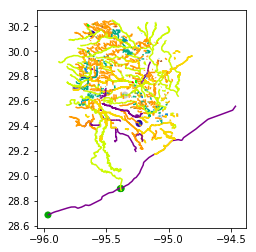

In [15]:
post_harvey_waterways.plot(column='waterway',cmap='nipy_spectral')

### Natural

In [16]:
post_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='natural')
post_harvey_nature = post_harvey_df[~post_harvey_df.natural.isnull()]
print(post_harvey_nature.natural.unique())
print(post_harvey_nature.shape)

['water' 'wood' 'coastline' 'scrub' 'marsh' 'undefined' 'grassland' 'mud'
 'wetland' 'beach' 'heath' 'grass' 'sand' 'tree_row' 'yes' 'riverbank']
(4781, 60)


In [41]:
post_harvey_natural_water.set_geometry(post_harvey_natural_water.geometry.apply(shapely.geometry.Polygon), inplace=True)

/home/mlt/anaconda2/lib/python2.7/site-packages/geopandas/geodataframe.py:149: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  frame[geo_column_name] = level


In [57]:
post_harvey_natural_water.to_file('vectors/post_harvey_natural_water.geojson', driver='GeoJSON')

In [40]:
post_harvey_natural_water = post_harvey_nature[post_harvey_nature.natural == 'water']

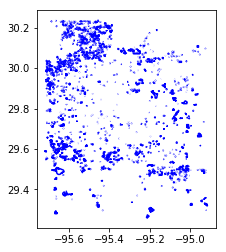

In [21]:
post_harvey_nature[post_harvey_nature.natural == 'water'].plot(color='blue')

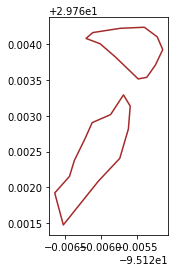

In [24]:
post_harvey_nature[post_harvey_nature.natural == 'mud'].plot(color='brown')

### Highway

In [26]:
post_harvey_df = geopandas_osm.osm.query_osm('way', poly, recurse='down', tags='highway')
post_harvey_roads = post_harvey_df[post_harvey_df.type == 'LineString'][['highway','name','geometry']]
pre_harvey_roads = post_harvey_roads[~post_harvey_roads.highway.isnull()]
print(post_harvey_roads.highway.unique())
print(post_harvey_roads.shape)

['residential' 'service' 'proposed' 'secondary_link' 'motorway_link'
 'tertiary' 'secondary' 'track' 'trunk' 'footway' 'trunk_link'
 'unclassified' 'path' 'primary_link' 'tertiary_link' 'cycleway'
 'bridleway' 'raceway' 'pedestrian' 'road' 'primary' 'construction'
 'motorway' 'steps' 'bus_stop' 'living_street' 'abandoned' 'demolished'
 'traffic_island' 'corridor' 'elevator']
(222546, 3)


In [29]:
post_harvey_roads.to_file('vectors/post_harvey_roads.geojson', 'GeoJSON')

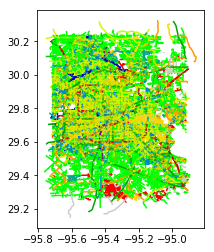

In [27]:
post_harvey_roads.plot(column='highway',cmap='nipy_spectral')

### Plotting layers 

In [6]:
post_harvey_building_centroids = gpd.read_file('vectors/post_harvey_building.geojson')
post_harvey_nature = gpd.read_file('vectors/post_harvey_natural_water.geojson')
post_harvey_roads = gpd.read_file('vectors/post_harvey_roads.geojson')

In [7]:
from scipy.misc import imresize
def resize(img, new_shape):
    img_resized = np.zeros(new_shape+(img.shape[2],)).astype('float32')
    for i in range(img.shape[2]):
        img_resized[:, :, i] = imresize(img[:, :, i], new_shape, interp='bicubic')
    return img_resized

fig, ax = plt.subplots(figsize=(30, 30))
for tiff in tiff_images[:3]:
    with rasterio.open(tiff) as src:
        img = src.read().transpose([1,2,0])
        img = resize(img, (240, 240))
    rioplot.show(img, with_bounds=True,ax=ax)
plt.show()

In [20]:
with rasterio.open(tiff_images[9]) as src:
    r, g, b = src.read()
    profile = src.profile
    profile.update(dtype=rasterio.uint8, count=3, compress='lzw')
    
total = np.zeros(r.shape)
for band in r, g, b:
    total += band
total /= 3

with rasterio.open('Data/test/test.tif', 'w', **profile) as dst:
    dst.write(total.astype(rasterio.uint8), 1)

# Whole Map of Houston with OSM features 

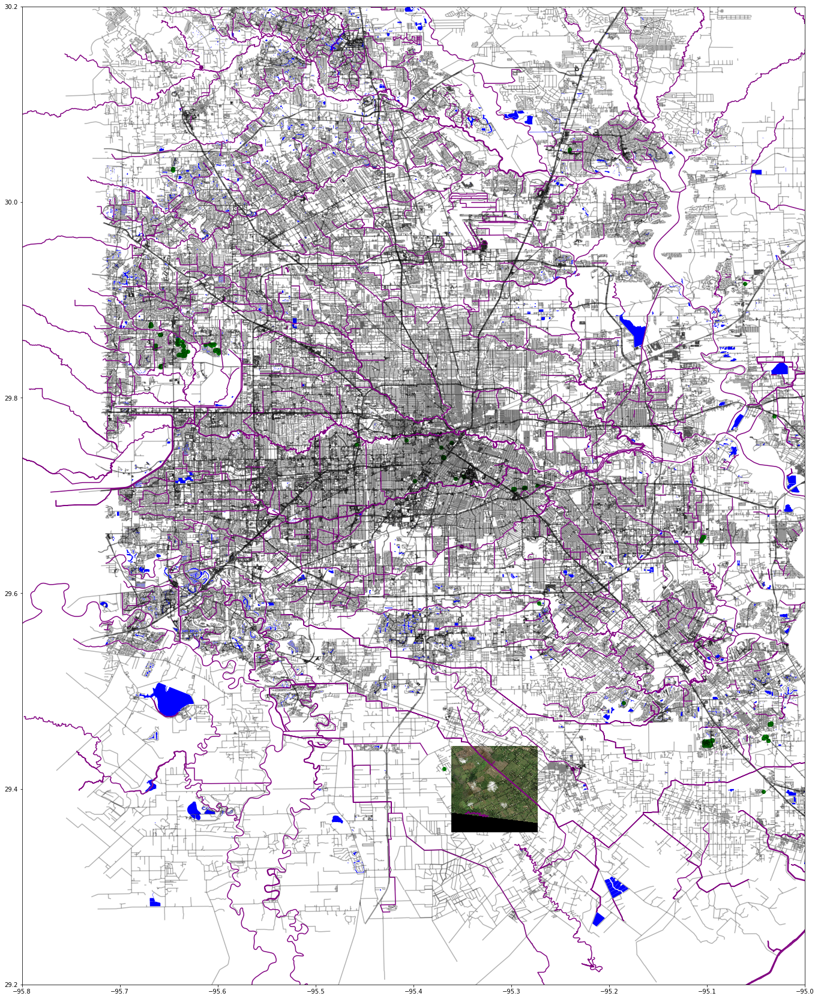

In [22]:
import rasterio.plot as rioplot
src1 = rasterio.open(random.choice(tiff_images))
fig, ax = plt.subplots(figsize=(30, 30))
rioplot.show(src1, with_bounds=True,ax=ax)
post_harvey_roads.plot(ax=ax,color='black',alpha=0.3)
post_harvey_waterways.plot(ax=ax,color='purple')
post_harvey_nature[post_harvey_nature.natural == 'water'].plot(ax=ax,color='blue')
post_harvey_building_centroids[post_harvey_building_centroids.building=='residential'].plot(ax=ax,color='green')
plt.ylim([29.2,30.2])
plt.xlim([-95.8,-95.0])
plt.show()

In [ ]:
#Clearing cache
import gc
del src1
gc.collect()

# MISCELLANEOUS 

## Checking Training Images and Vectors (Sanity Check)

In [3]:
import cv2
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import os
import rasterio
import shapely.geometry

%matplotlib inline

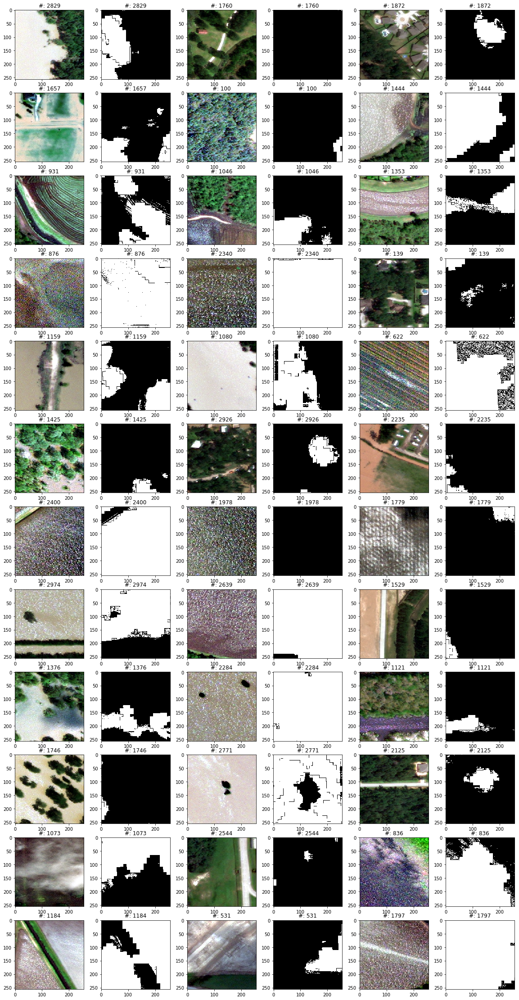

In [27]:
i = 1
fig = plt.figure(figsize=(20,40))
rando = np.random.choice(range(0,3200),72,replace=False)
for tile_no in rando:
    if i <= 72:
        img = np.load('training_tiles3/%d_img.npy'%tile_no)
        mask = np.load('training_tiles3/%d_mask.npy'%tile_no)
        ax1 = fig.add_subplot(12,6,i)
        ax1.title.set_text('#: ' + str(tile_no))
        plt.imshow(scale_bands(img[:, :, :]))
        ax2 = fig.add_subplot(12,6,i+1)
        ax2.title.set_text('#: ' + str(tile_no))
        plt.imshow(mask,cmap=plt.cm.gray)
        i+=2
    

image with black cutoffs: 1579, 1456, 1364, 1495?

In [59]:
img = np.load('training_tiles/%d_img.npy'%1364)

In [64]:
img2 = np.load('training_tiles/%d_img.npy'%1579)

In [63]:
img.mean()

0.0

In [26]:
img.shape

(256, 256, 3)

In [25]:
len(cutouts)

2

In [24]:
cutouts = []
for tile in range(0,200):
    count = 0
    img = np.load('training_tiles3/%d_img.npy'%tile)
    for pixel in img:
        for rgb in pixel:
            if rgb.sum() == 0:
                count += 1
            if count == 10:
                cutouts.append(tile)
                continue
len(cutouts)

2

In [ ]:
i = 1
fig = plt.figure(figsize=(20,20))

while i < 31:
    tile_no = random.choice(cutouts)
    img = np.load('training_tiles/%d_img.npy'%tile_no)
    ax1 = fig.add_subplot(5,6,i)
    ax1.title.set_text('#: ' + str(tile_no))
    plt.imshow(img)
    i+=1
    

In [4]:
path = 'training_tiles/'
tiles = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]

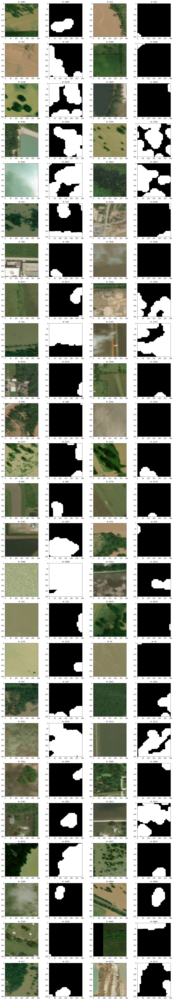

In [8]:
i = 1
fig = plt.figure(figsize=(20,120))

for tile in np.random.choice(tiles,50,replace=False):
    tile_no = int(re.search(r'\/(.*)\_', tile).group(1))
    img = np.load('training_tiles/%d_img.npy'%tile_no)
    mask = np.load('training_tiles/%d_mask.npy'%tile_no)
    ax1 = fig.add_subplot(25,4,i)
    ax1.title.set_text('#: ' + str(tile_no))
    plt.imshow(img)
    ax2 = fig.add_subplot(25,4,i+1)
    ax2.title.set_text('#: ' + str(tile_no))
    plt.imshow(mask,cmap=plt.cm.gray)
    i+=2

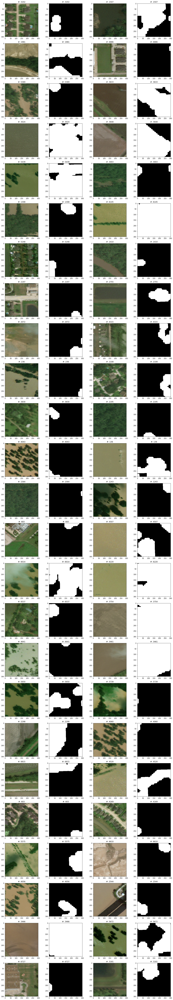

In [9]:
path = 'training_tiles/'
tiles = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]
i = 1
fig = plt.figure(figsize=(20,120))

for tile in np.random.choice(tiles,50,replace=False):
    tile_no = int(re.search(r'\/(.*)\_', tile).group(1))
    img = np.load('training_tiles/%d_img.npy'%tile_no)
    mask = np.load('training_tiles/%d_mask.npy'%tile_no)
    ax1 = fig.add_subplot(25,4,i)
    ax1.title.set_text('#: ' + str(tile_no))
    plt.imshow(img)
    ax2 = fig.add_subplot(25,4,i+1)
    ax2.title.set_text('#: ' + str(tile_no))
    plt.imshow(mask,cmap=plt.cm.gray)
    i+=2

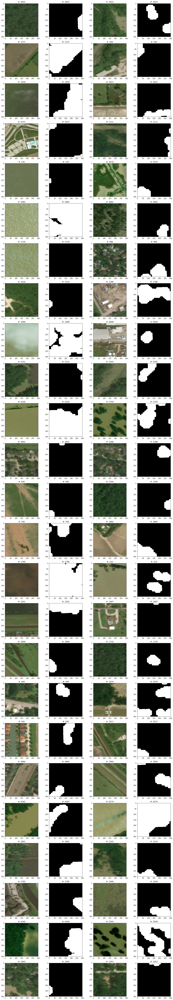

In [10]:
path = 'training_tiles/'
tiles = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]
i = 1
fig = plt.figure(figsize=(20,120))

for tile in np.random.choice(tiles,50,replace=False):
    tile_no = int(re.search(r'\/(.*)\_', tile).group(1))
    img = np.load('training_tiles/%d_img.npy'%tile_no)
    mask = np.load('training_tiles/%d_mask.npy'%tile_no)
    ax1 = fig.add_subplot(25,4,i)
    ax1.title.set_text('#: ' + str(tile_no))
    plt.imshow(img)
    ax2 = fig.add_subplot(25,4,i+1)
    ax2.title.set_text('#: ' + str(tile_no))
    plt.imshow(mask,cmap=plt.cm.gray)
    i+=2

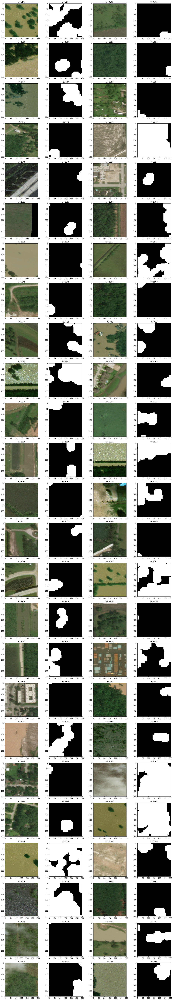

In [11]:
path = 'training_tiles/'
tiles = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]
i = 1
fig = plt.figure(figsize=(20,120))

for tile in np.random.choice(tiles,50,replace=False):
    tile_no = int(re.search(r'\/(.*)\_', tile).group(1))
    img = np.load('training_tiles/%d_img.npy'%tile_no)
    mask = np.load('training_tiles/%d_mask.npy'%tile_no)
    ax1 = fig.add_subplot(25,4,i)
    ax1.title.set_text('#: ' + str(tile_no))
    plt.imshow(img)
    ax2 = fig.add_subplot(25,4,i+1)
    ax2.title.set_text('#: ' + str(tile_no))
    plt.imshow(mask,cmap=plt.cm.gray)
    i+=2

# Trying to see different versions of the img tiles look the same 

In [35]:
path1 = 'training_tiles/'
tiles1 = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]

path2 = "/media/mlt/Passport 2TB/Morgan's Files/training_tiles/"
tiles2 = [os.path.join(path, image_name) 
               for image_name in os.listdir(path) 
               if image_name.lower().endswith('img.npy')]

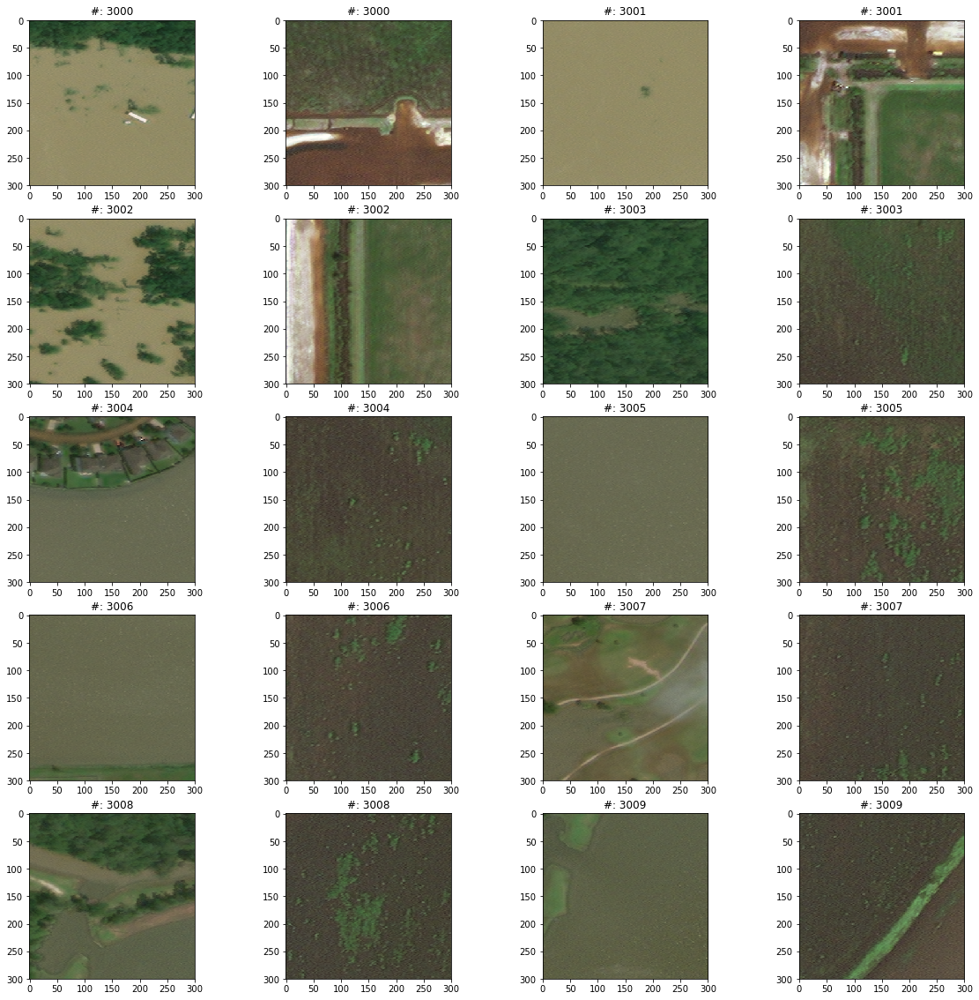

In [51]:
i = 1
fig = plt.figure(figsize=(20,20))

for tile_no in range(3000,3021):
    if i <= 20:
        tile_no = str(tile_no)
        img1 = np.load(path1+tile_no+'_img.npy')
        img2 = np.load(path2+tile_no+'_img.npy')
        ax1 = fig.add_subplot(5,4,i)
        ax1.title.set_text('#: ' + tile_no)
        plt.imshow(img1)
        ax2 = fig.add_subplot(5,4,i+1)
        ax2.title.set_text('#: ' + tile_no)
        plt.imshow(img2)
        i+=2